In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
init_notebook_mode()

%matplotlib inline 

from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [5]:
df = pd.read_csv("cleaned.csv")
df0 = df
tran = pd.read_csv("train_2016_v2.csv")

In [43]:
#clean up the transaction dates by leaving only the month for easier graphics
yearmonth = []
for i in range(0,len(tran)):
    yearmonth.append(tran["transactiondate"][i][0:7])
    
tran["yearmonth"] = yearmonth

tran  =tran.sort_values(by=['yearmonth'])

In [44]:
transaction = pd.merge(tran,df, on='parcelid', how='inner')
transaction = transaction.sort_values(by=['yearmonth'])

In [45]:
#transaction.groupby('fips').count()["parcelid"]
#fips = county code
#6037 = los angeles
#6059 = Orange county
#6111 = Ventura County

In [46]:
jan = transaction[transaction["yearmonth"] == '2016-01'].groupby('fips').count()["parcelid"].values.tolist()
feb = transaction[transaction["yearmonth"] == '2016-02'].groupby('fips').count()["parcelid"].values.tolist()
march = transaction[transaction["yearmonth"] == '2016-03'].groupby('fips').count()["parcelid"].values.tolist()
april = transaction[transaction["yearmonth"] == '2016-04'].groupby('fips').count()["parcelid"].values.tolist()
may = transaction[transaction["yearmonth"] == '2016-05'].groupby('fips').count()["parcelid"].values.tolist()
june = transaction[transaction["yearmonth"] == '2016-06'].groupby('fips').count()["parcelid"].values.tolist()
july = transaction[transaction["yearmonth"] == '2016-07'].groupby('fips').count()["parcelid"].values.tolist()
aug = transaction[transaction["yearmonth"] == '2016-08'].groupby('fips').count()["parcelid"].values.tolist()
sep = transaction[transaction["yearmonth"] == '2016-09'].groupby('fips').count()["parcelid"].values.tolist()
octo = transaction[transaction["yearmonth"] == '2016-10'].groupby('fips').count()["parcelid"].values.tolist()
nov = transaction[transaction["yearmonth"] == '2016-11'].groupby('fips').count()["parcelid"].values.tolist()
dec = transaction[transaction["yearmonth"] == '2016-12'].groupby('fips').count()["parcelid"].values.tolist()

pcts = [jan,feb,march,april, may,june, july,octo, sep, nov, dec]
l1= []
l2 = []
l3 = []
for i in pcts:
    l1.append(i[0])
    l2.append(i[1])
    l3.append(i[2])

# Zillow's California Housing Market 

### 1. Where are the transactions located and what type of properties are people buying?
### 2. What are the high volume of transaction months through out the year? 
* There is a high volumne of transactions happening in May, June, and July
* Most of these transactions occur in Los Angeles

In [ ]:
import plotly
import plotly.graph_objs as go
x = ["January", "February", "March","April","May", "June","July","August", "September", "October","November","December"]
trace1 = go.Bar(
    x=x,
    y=l1,
    name='Los Angeles'
)
trace2 = go.Bar(
    x=x,
    y=l2,
    name='Orange County'
)
trace3 = go.Bar(
    x=x,
    y=l3,
    name='Ventura County'
)

data = [trace1, trace2,trace3]
layout = go.Layout(
    barmode='stack',
    title = "Number of Transactions by Month"
)

fig = go.Figure(data=data, layout=layout)
plotly.offline.iplot(fig, filename='stacked-bar')

In [ ]:
convert_type={31.0: 'Commercial', 46.0: 'MultiStory Store', 47.0: 'Store/Office',
      246.0: 'Duplex',247.0: 'Triplex',248.0:'Quadruplex', 260.0: 'Residential General',
      261.0: 'Single Family Residential',262.0: 'Rural Residence',263.0: 'Mobile Home',
      264.0: 'Townhouse', 265.0: 'Cluster Home', 266.0: 'Condominium',267.0: 'Cooperative',
      268.0: 'Row House',269.0: 'Planned Unit Development', 270.0: 'Residential Common Area',
      271.0: 'Timeshare', 273.0: 'Bungalow', 274.0: 'Zero Lot Line', 275.0: 'Manufactured/Modular Homes',
      276.0: 'Patio Home', 279.0: 'Inferred Single Family', 290.0: 'Vacant Land',291.0: 'Vacant Land' }

transaction['propertylandusetypeid']=transaction['propertylandusetypeid'].map(convert_type)

LA = transaction[transaction["fips"] ==6037]["propertylandusetypeid"].value_counts()#6037 = los angeles
orange = transaction[transaction["fips"] ==6059]["propertylandusetypeid"].value_counts()#6037 = los angeles
ventura = transaction[transaction["fips"] ==6111]["propertylandusetypeid"].value_counts() #6111 = Ventura County

In [ ]:
import plotly
import plotly.graph_objs as go

trace1 = go.Bar(
    x=LA.index[0:3],
    y=LA.tolist()[0:3],
    name='Los Angeles',
)
trace2 = go.Bar(
    x=orange.index[0:2],
    y=orange.tolist()[0:2],
    name='Orange County'
)

trace3 = go.Bar(
    x=ventura.index[0:3],
    y=ventura.tolist()[0:3],
    name='Ventura County'
)

data = [trace1, trace2, trace3]
layout = go.Layout(
    barmode='group'
)

fig = go.Figure(data=data, layout=layout)
plotly.offline.iplot(fig, filename='grouped-bar')

In [ ]:
transaction["latitude"] = transaction["latitude"]/1000000
transaction["longitude"] = transaction["longitude"]/1000000

np.random.seed(11452)
train = np.random.rand(len(transaction)) <0.5
trans_train = transaction[train]
#len(trans_train)

### 3. Are there any property features that make a house more popular for purchase and where are they located? 
### 4. Do these popular property features differ by county?
### 5. Are there any underlying relationships between these housing features and its locations?

### Geolcation Plot with Prices of Properties
* The first geolocation plot indicates that transactions are located in Los Angeles and roughly cost around the 1 million USD threshold. 
* Ventura and orange county seem to cover a small part of the transactions but more of the higher priced properties. 
* A small cluster of high price property transactions are in malibu, beverly hills, and Newport beach. 

In [59]:
import plotly
from plotly.plotly import iplot
import plotly.graph_objs as go

mapbox_access_token = 'pk.eyJ1IjoiYmlwYXJ0aXRlaHlwZXJjdWJlIiwiYSI6ImNqczFjZzUydjF0MGc0OW1sYWIwYW5lY2UifQ.l6OVeSa3poXp6S4s8km8kA'
map_style = "mapbox://styles/bipartitehypercube/cjs26r8sw1cy31fqjhopqigtj"

scl = [0,"rgb(0,0,0)"],[0.25,"rgb(0, 0, 128)"],[0.5,"rgb(0, 25, 255)"],\
[0.75,"rgb(0, 0, 205)"],[1,"rgb(250, 250, 250)"]


data = [go.Scattermapbox(
            lat=trans_train['latitude'],
            lon=trans_train['longitude'],
            text = trans_train['taxvaluedollarcnt'].astype(str) + ' Dollars',
            mode='markers',
            marker = dict(color = (trans_train['taxvaluedollarcnt']),colorscale = scl,reversescale = True,opacity = 0.5,size = 5,
            colorbar = dict(thickness = 10,titleside = "right",
                            outlinecolor = "rgba(68, 68, 68, 0)",
                            ticks = "outside",ticklen = 3,
                            showticksuffix = "last",
                        ticksuffix = " Dollars",dtick = 1000000)))]

layout = go.Layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(lat=34,lon=-118.5),
        style= map_style,
        pitch=0,
        zoom=7,),
    
    title = 'Transaction location with Property Price',
)



fig = dict(data=data, layout=layout)
plotly.offline.iplot(fig, filename='Geolocation of properties') 

### Geolocation Plot with Size of the Property
* The geolocation plot shows the size of the house based on the location people are buying.
* The size of the house isn't directly correlated with the price since the suburbs around Los Angeles seems to be bigger and cheaper. Specifically around the Palm dale, Yorba linda, and Villa Park. 
* Ventura and Orange county also includes the larger and more expensive properties in California

In [60]:
import plotly
from plotly.plotly import iplot
import plotly.graph_objs as go

mapbox_access_token = 'pk.eyJ1IjoiYmlwYXJ0aXRlaHlwZXJjdWJlIiwiYSI6ImNqczFjZzUydjF0MGc0OW1sYWIwYW5lY2UifQ.l6OVeSa3poXp6S4s8km8kA'
map_style = "mapbox://styles/bipartitehypercube/cjs26r8sw1cy31fqjhopqigtj"

scl = [0,"rgb(0,0,0)"],[0.25,"rgb(0, 0, 128)"],[0.5,"rgb(0, 25, 255)"],\
[0.75,"rgb(0, 0, 205)"],[1,"rgb(250, 250, 250)"]


data = [go.Scattermapbox(
            lat=trans_train['latitude'],
            lon=trans_train['longitude'],
            text = trans_train["calculatedfinishedsquarefeet"].astype(str) + ' Square Feet',
            mode='markers',
            marker = dict(color = (trans_train["calculatedfinishedsquarefeet"]),colorscale = scl,reversescale = True,opacity = 0.7,size = 5,
            colorbar = dict(thickness = 10,titleside = "right",
                            outlinecolor = "rgba(68, 68, 68, 0)",
                            ticks = "outside",ticklen = 3,
                            showticksuffix = "last",
                        ticksuffix = " Square Feet",dtick = 700)))]

layout = go.Layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(lat=34,lon=-118.5),
        style= map_style,
        pitch=0,
        zoom=7,),
    title = 'Transaction location with Property Size',
)



fig = dict(data=data, layout=layout)
plotly.offline.iplot(fig, filename='Geolocation of properties') 

### Geolocation Plot with Price Per Square Feet
* The plot shows a relationship with the two previous plots 
* Very interestingly, the price per square feet in both the Ventura county and Orange county are much cheaper. 
* The properties that people are purchasing in central Los Angeles are relatively low.
* The cluster around LA Palmdale airport seems to be relatively cheap per square feet but large in property size. 

In [61]:
import plotly
from plotly.plotly import iplot
import plotly.graph_objs as go

mapbox_access_token = 'pk.eyJ1IjoiYmlwYXJ0aXRlaHlwZXJjdWJlIiwiYSI6ImNqczFjZzUydjF0MGc0OW1sYWIwYW5lY2UifQ.l6OVeSa3poXp6S4s8km8kA'
map_style = "mapbox://styles/bipartitehypercube/cjs26r8sw1cy31fqjhopqigtj"

scl = [0,"rgb(0,0,0)"],[0.25,"rgb(0, 0, 128)"],[0.5,"rgb(0, 25, 255)"],\
[0.75,"rgb(0, 0, 205)"],[1,"rgb(250, 250, 250)"]


data = [go.Scattermapbox(
            lat=trans_train['latitude'],
            lon=trans_train['longitude'],
            text = (trans_train['taxvaluedollarcnt']/trans_train["calculatedfinishedsquarefeet"]).astype(str) + ' Dollars Per Square Feet',
            mode='markers',
            marker = dict(color = (trans_train['taxvaluedollarcnt']/trans_train["calculatedfinishedsquarefeet"]),colorscale = scl,reversescale = True,opacity = 0.7,size = 5,
            colorbar = dict(thickness = 10,titleside = "right",
                            outlinecolor = "rgba(68, 68, 68, 0)",
                            ticks = "outside",ticklen = 3,
                            showticksuffix = "last",
                        ticksuffix = " Dollars Per Square Feet",dtick = 700)))]

layout = go.Layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(lat=34,lon=-118.5),
        style= map_style,
        pitch=0,
        zoom=7,),
    title = 'Transaction location',
)



fig = dict(data=data, layout=layout)
plotly.offline.iplot(fig, filename='Geolocation of properties') 

In [62]:
freq = df["yearbuilt"].value_counts()
freq = freq.values
freq = freq.tolist()

years = df["yearbuilt"].unique()
years = years.tolist()

years1 = transaction["yearbuilt"].unique()
years1 = years1.tolist()

freq1 = transaction["yearbuilt"].value_counts()
freq1 = freq1.values
freq1 = freq1.tolist()

ly0 = []
for i in years:
    ly0.append(int(i))
    
ly1 = []
for i in years1:
    ly1.append(int(i))

In [63]:
overall = pd.DataFrame({'yearbuilt': ly0,'Marketprop': freq})
transact = pd.DataFrame({'yearbuilt': ly1,'Transactionofprop': freq1})

comparison = pd.merge(overall,transact, on = 'yearbuilt', how = 'outer')
comparison = comparison.fillna(0)
#comparison['yearbuilt'] = comparison['yearbuilt'].apply(str)

In [64]:
from sklearn import preprocessing

min_max_scaler = preprocessing.MinMaxScaler()
column_names_to_normalize = ['Marketprop','Transactionofprop']
x = comparison[column_names_to_normalize].values
x_scaled = min_max_scaler.fit_transform(x)
df_temp = pd.DataFrame(x_scaled, columns=column_names_to_normalize, index = comparison.index)
comparison[column_names_to_normalize] = df_temp

In [65]:
#comparison[comparison["Transactionofprop"] > 0.8]
#comparison[comparison["Marketprop"] > 0.8]

## 6. Does the year built of the property affect the purchase of these houses? 
* The left plot (blue line) indicates that the overal supply by the age of the house in the market. 

* The left plot (orange line) indicates the demand of properties based on the year built (age). 
* The demand does seem to match in general the supply, since the two line charts overlay from the range 1900s to present. However they spike at different built years. 
* The orangle line in the left plot spikes from 1950s to 1960s and from 1980s to 1990s. This may suggest people are buying houses from 1960s for remodeling and 1980s for living.
* The right plot shows the prediction error of housing prices by Zillow. The Zillow estimates are relatively accurate. By locating the high fluctions in prediction error we can understand that the house built in 1880s to 1940s are highly volatile and can reflect the lower demand of those properties in the the left plot. 

/Users/chi/anaconda/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



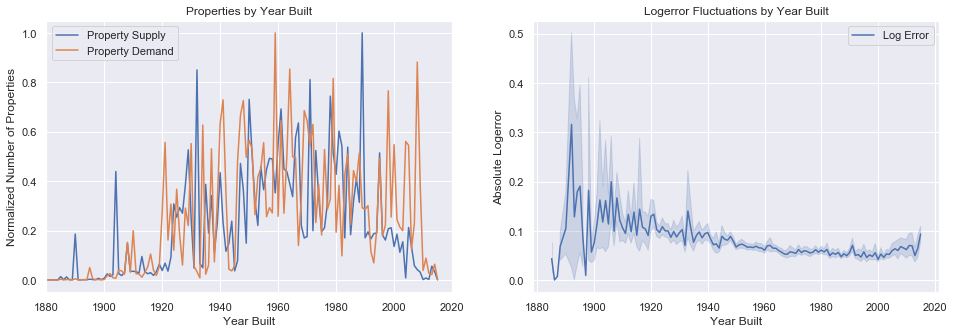

In [66]:
import matplotlib.pyplot as plt
from matplotlib import pylab
import datetime
import numpy as np
import seaborn as sns; sns.set()

palette = dict(zip([1,2],
                   sns.color_palette("nipy_spectral_r", 4)))
fig, (ax1, ax2)= plt.subplots(ncols = 2,figsize=(16, 5))
ax1 = sns.lineplot(comparison['yearbuilt']  ,comparison["Marketprop"], data = comparison, palette = palette,ax=ax1, label = "Property Supply")


ax1 = sns.lineplot(comparison['yearbuilt'],comparison["Transactionofprop"], data = comparison, palette = palette,ax=ax1, label = "Property Demand")
ax1.set(xlabel ='Year Built')
ax1.set(ylabel = 'Normalized Number of Properties')
ax1.set_title('Properties by Year Built')
ax1.set_xlim(1880,2020)
leg =ax1.legend()
ax2 = sns.lineplot(transaction['yearbuilt'],abs(transaction["logerror"]), data = transaction, ax = ax2, label = "Log Error")
ax2.set(xlabel ='Year Built')
ax2.set(ylabel = 'Absolute Logerror')
ax2.set_title("Logerror Fluctuations by Year Built")
ax1.set_xlim(1880,2020)

plt.show()